### Climatology difference analysis for the IFS-AMIP twin experiments with and without eddies in the SST forcing
- Inspired by paper Ma et al 2015 on the effect of eddies on weather patterns https://www.nature.com/articles/srep17785
- Analysed here is the DJF climatology between the twin experiments with and w/o eddy forcing in the SSTs in terms of differences in the mean for the following variables:
    - mean surface latent heat flux
    - 10m zonal wind
    - mean sea level pressure
    - 2m air temperature
    - sea surface temperature
- The significance test uses spicy.stats.wilcoxon https://docs.scipy.org/doc/scipy/reference/generated/scipy.stats.wilcoxon.html and xr.apply_ufunc to parallelize these calculations using chunks https://docs.xarray.dev/en/stable/generated/xarray.apply_ufunc.html

Iuliia Polkova polkova@dkrz.de

In [1]:
import xarray as xr
import pandas as pd
import numpy as np
import intake
from dask.diagnostics import ProgressBar

import cartopy.crs as ccrs
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import cmocean.cm as cmo
import seaborn as sns

import hvplot.xarray
import xskillscore as xs

In [2]:
def ifs_to_latlon(ds):
    '''
    Uses the latitude-longitude information encoded in the regular grid IFS output to reconstructed the regular grid
    '''
    return ds.rename({'value':'latlon'}).set_index(latlon=("lat","lon")).unstack("latlon")
def ifs_fix_time_for_monthly_data(ds):
    '''
    Monthly mean data has the time axis encoded incorrectly.
    This function shifts it back by one day
    '''
    return ds.assign_coords(time=ds['time']- pd.Timedelta('1D'))

## Open and inspect the catalogue

In [3]:
cat = intake.open_catalog('https://raw.githubusercontent.com/eerie-project/intake_catalogues/main/eerie.yaml')\
                          ['dkrz']['disk']['model-output']['ifs-amip']

In [4]:
list(cat)

['amip-hist-obs.atmos.gr025',
 'amip-hist-obs-lr30.atmos.gr025',
 'amip-ng-obs.atmos.gr025',
 'amip-ng-obs-lr30.atmos.gr025']

In [5]:
list(cat['amip-hist-obs.atmos.gr025'])

['2D_const_0.25deg',
 '2D_6h_0.25deg',
 '2D_24h_0.25deg',
 '2D_monthly_0.25deg',
 '3D_6h_0.25deg',
 '3D_24h_0.25deg',
 '3D_monthly_0.25deg']

## Load the data to dask (lazy!)

In [6]:
ds_smooth = cat['amip-hist-obs-lr30.atmos.gr025']['2D_monthly_0.25deg'].to_dask()
ds = cat['amip-hist-obs.atmos.gr025']['2D_monthly_0.25deg'].to_dask()
# The following is necessary for MONTHLY data, NOT step data!
ds_smooth = ifs_fix_time_for_monthly_data(ds_smooth)
ds = ifs_fix_time_for_monthly_data(ds)

In [7]:
ds_smooth = ifs_to_latlon(ds_smooth)
ds = ifs_to_latlon(ds)

# compute grid-box area
area = get_area(ds.sst)

In [8]:
ds

<xarray.Dataset>
Dimensions:  (lat: 721, lon: 1440, time: 132)
Coordinates:
  * lat      (lat) float64 -90.0 -89.75 -89.5 -89.25 ... 89.25 89.5 89.75 90.0
  * lon      (lon) float64 0.0 0.25 0.5 0.75 1.0 ... 359.0 359.2 359.5 359.8
  * time     (time) datetime64[ns] 2010-01-31 2010-02-28 ... 2020-12-31
Data variables: (12/50)
    10si     (time, lat, lon) float64 dask.array<chunksize=(1, 721, 1440), meta=np.ndarray>
    10u      (time, lat, lon) float64 dask.array<chunksize=(1, 721, 1440), meta=np.ndarray>
    10v      (time, lat, lon) float64 dask.array<chunksize=(1, 721, 1440), meta=np.ndarray>
    2d       (time, lat, lon) float64 dask.array<chunksize=(1, 721, 1440), meta=np.ndarray>
    2t       (time, lat, lon) float64 dask.array<chunksize=(1, 721, 1440), meta=np.ndarray>
    cape     (time, lat, lon) float64 dask.array<chunksize=(1, 721, 1440), meta=np.ndarray>
    ...       ...
    swvl4    (time, lat, lon) float64 dask.array<chunksize=(1, 721, 1440), meta=np.ndarray>
    tcc      (time, lat, lon) float64 dask.array<chunksize=(1, 721, 1440), meta=np.ndarray>
    tciw     (time, lat, lon) float64 dask.array<chunksize=(1, 721, 1440), meta=np.ndarray>
    tclw     (time, lat, lon) float64 dask.array<chunksize=(1, 721, 1440), meta=np.ndarray>
    tcwv     (time, lat, lon) float64 dask.array<chunksize=(1, 721, 1440), meta=np.ndarray>
    tprate   (time, lat, lon) float64 dask.array<chunksize=(1, 721, 1440), meta=np.ndarray>
Attributes:
    edition:            1
    centre:             ecmf
    centreDescription:  European Centre for Medium-Range Weather Forecasts
    subCentre:          0
    history:            🪄🧙‍♂️🔮 magic dataset assembly provided by gribscan.IF...

### Differences between the AMIP run with (1) prescribed eddies in SSTs and (2) smoothed SSTs.

In [9]:
# difference at each timestep
sst_diff = ds.sst - ds_smooth.sst
msl_diff = ds.msl - ds_smooth.msl
u10_diff = ds["10u"] - ds_smooth["10u"]
t2m_diff = ds["2t"] - ds_smooth["2t"]
prc_diff = ds["tprate"] - ds_smooth["tprate"]
lhf_diff = ds["mslhfl"] - ds_smooth["mslhfl"]

In [10]:
#ds.sst.isel(time=0).plot()
p1=lhf_diff[0].hvplot.image(cmap="RdBu_r", width=1000, height=500, coastline=True)
p1.redim.range(value=(-10, 10))


:Overlay
   .Image.I     :Image   [lon,lat]   (mslhfl)
   .Coastline.I :Feature   [Longitude,Latitude]

### Winter season climatology and climatology difference

In [11]:
# Mean surface latent heat flux 
lhf_clm=ds["mslhfl"].groupby("time.season").mean("time")
lhf_smooth_clm=ds_smooth["mslhfl"].groupby("time.season").mean("time")
lhf_clm_diff = lhf_clm - lhf_smooth_clm

# 10 metre U wind component
u10_clm=ds["10u"].groupby("time.season").mean("time")
u10_smooth_clm=ds_smooth["10u"].groupby("time.season").mean("time")
u10_clm_diff = u10_clm - u10_smooth_clm

# Mean sea level pressure
msl_clm=ds.msl.groupby("time.season").mean("time")/100
msl_smooth_clm=ds_smooth.msl.groupby("time.season").mean("time")/100
msl_clm_diff = msl_clm - msl_smooth_clm

# sea surface temperature
sst_clm=ds.sst.groupby("time.season").mean("time")
sst_smooth_clm=ds_smooth.sst.groupby("time.season").mean("time")
sst_clm_diff = sst_clm - sst_smooth_clm

# 2 metre temperature
t2m_clm=ds["2t"].groupby("time.season").mean("time")
t2m_smooth_clm=ds_smooth["2t"].groupby("time.season").mean("time")
t2m_clm_diff = t2m_clm - t2m_smooth_clm

In [12]:
sst_clm_diff[0].hvplot.image(cmap="RdBu_r", width=1000, height=500, coastline=True)

:Overlay
   .Image.I     :Image   [lon,lat]   (sst)
   .Coastline.I :Feature   [Longitude,Latitude]

### Wilcoxon significance test for the climatology differences

In [13]:
def month_selector(month):
    return (month >= 1) & (month <= 2) | (month >=12) # select Jan, Feb, Dec

def djf_average(x_djf):
    x_djf = x_djf.rolling(time = 3).mean() # rolling mean over three months: JFD, FDJ, DJF, ...
    x_djf = x_djf[x_djf.time.dt.month == 12] # pick rolling mean that starts with Dec
    return x_djf


In [14]:
# Mean surface latent heat flux 
lhf_djf = ds["mslhfl"].sel(time=month_selector(ds["mslhfl"]['time.month']))
lhf_djf = djf_average(lhf_djf)

lhf_smooth_djf = ds_smooth["mslhfl"].sel(time=month_selector(ds_smooth["mslhfl"]['time.month']))
lhf_smooth_djf = djf_average(lhf_smooth_djf)

# 10 metre U wind component
u10_djf = ds["10u"].sel(time=month_selector(ds["10u"]['time.month']))
u10_djf = djf_average(u10_djf)

u10_smooth_djf = ds_smooth["10u"].sel(time=month_selector(ds_smooth["10u"]['time.month']))
u10_smooth_djf = djf_average(u10_smooth_djf)

# Mean sea level pressure
msl_djf = ds["msl"].sel(time=month_selector(ds["msl"]['time.month']))
msl_djf = djf_average(msl_djf)

msl_smooth_djf = ds_smooth["msl"].sel(time=month_selector(ds_smooth["msl"]['time.month']))
msl_smooth_djf = djf_average(msl_smooth_djf)

# sea surface temperature
sst_djf = ds["sst"].sel(time=month_selector(ds["sst"]['time.month']))
sst_djf = djf_average(sst_djf)

sst_smooth_djf = ds_smooth["sst"].sel(time=month_selector(ds_smooth["sst"]['time.month']))
sst_smooth_djf = djf_average(sst_smooth_djf)

# 2m temperature
t2m_djf = ds["2t"].sel(time=month_selector(ds["2t"]['time.month']))
t2m_djf = djf_average(t2m_djf)

t2m_smooth_djf = ds_smooth["2t"].sel(time=month_selector(ds_smooth["2t"]['time.month']))
t2m_smooth_djf = djf_average(t2m_smooth_djf)


In [15]:
import scipy.stats as stats

def wilcoxon_gufunc(x,y):
    s,p = stats.wilcoxon(x, y) 
    return p

In [16]:
def wilcoxon_xr(x, y):
    return xr.apply_ufunc(
        wilcoxon_gufunc, # first the function
        x,  # now arguments in the order expected by the function
        y,
        input_core_dims=[["time"],["time"]],  # list with one entry per arg
        output_core_dims=[[]],
        #exclude_dims=set(("lat",)),
        dask="parallelized",
        output_dtypes=[float],
		#dask_gufunc_kwargs={'allow_rechunk': True},
        vectorize=True,  # loop over non-core dims
	)


In [17]:
lhf_wt = wilcoxon_xr(lhf_djf.chunk({"time": -1, "lon":100, "lat":100}), lhf_smooth_djf.chunk({"time": -1, "lon":100, "lat":100})).compute()
u10_wt = wilcoxon_xr(u10_djf.chunk({"time": -1, "lon":100, "lat":100}), u10_smooth_djf.chunk({"time": -1, "lon":100, "lat":100})).compute()
msl_wt = wilcoxon_xr(msl_djf.chunk({"time": -1, "lon":100, "lat":100}), msl_smooth_djf.chunk({"time": -1, "lon":100, "lat":100})).compute()
#sst_wt = wilcoxon_xr(sst_djf.chunk({"time": -1, "lon":100, "lat":100}), sst_smooth_djf.chunk({"time": -1, "lon":100, "lat":100})).compute()
t2m_wt = wilcoxon_xr(t2m_djf.chunk({"time": -1, "lon":100, "lat":100}), t2m_smooth_djf.chunk({"time": -1, "lon":100, "lat":100})).compute()
t2m_wt

/sw/spack-levante/mambaforge-22.9.0-2-Linux-x86_64-kptncg/lib/python3.10/site-packages/scipy/stats/_morestats.py:3145: UserWarning: Exact p-value calculation does not work if there are ties. Switching to normal approximation.
  warnings.warn("Exact p-value calculation does not work if there are "


<xarray.DataArray '2t' (lat: 721, lon: 1440)>
array([[0.08300781, 0.08300781, 0.08300781, ..., 0.08300781, 0.08300781,
        0.08300781],
       [0.05371094, 0.05371094, 0.05371094, ..., 0.05371094, 0.05371094,
        0.05371094],
       [0.06738281, 0.06738281, 0.06738281, ..., 0.06738281, 0.06738281,
        0.06738281],
       ...,
       [0.36523438, 0.36523438, 0.36523438, ..., 0.36523438, 0.36523438,
        0.36523438],
       [0.3203125 , 0.3203125 , 0.3203125 , ..., 0.3203125 , 0.3203125 ,
        0.3203125 ],
       [0.46484375, 0.46484375, 0.46484375, ..., 0.46484375, 0.46484375,
        0.46484375]])
Coordinates:
  * lat      (lat) float64 -90.0 -89.75 -89.5 -89.25 ... 89.25 89.5 89.75 90.0
  * lon      (lon) float64 0.0 0.25 0.5 0.75 1.0 ... 359.0 359.2 359.5 359.8

In [18]:
#t2m_wt.hvplot.image(cmap="RdBu_r", width=1000, height=500, coastline=True)

In [19]:
# H0: means are the same
# for p-value smaller 0.05 (0.1) H0 can be rejected, thus means between the experiments are not the same
lhf_clmdiff_mask=lhf_clm_diff[0].where(lhf_wt < 0.1)
u10_clmdiff_mask=u10_clm_diff[0].where(u10_wt < 0.1)
msl_clmdiff_mask=msl_clm_diff[0].where(msl_wt < 0.1)
#sst_clmdiff_mask=sst_clm_diff[0].where(sst_wt < 0.1)
t2m_clmdiff_mask=t2m_clm_diff[0].where(t2m_wt < 0.1)


### Plot clm differences 

/sw/spack-levante/mambaforge-22.9.0-2-Linux-x86_64-kptncg/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:1714: UserWarning: The following kwargs were not used by contour: 'linewidth'
  result = matplotlib.axes.Axes.contourf(self, *args, **kwargs)


Text(0.5, 1.0, 't2m DJF diff')

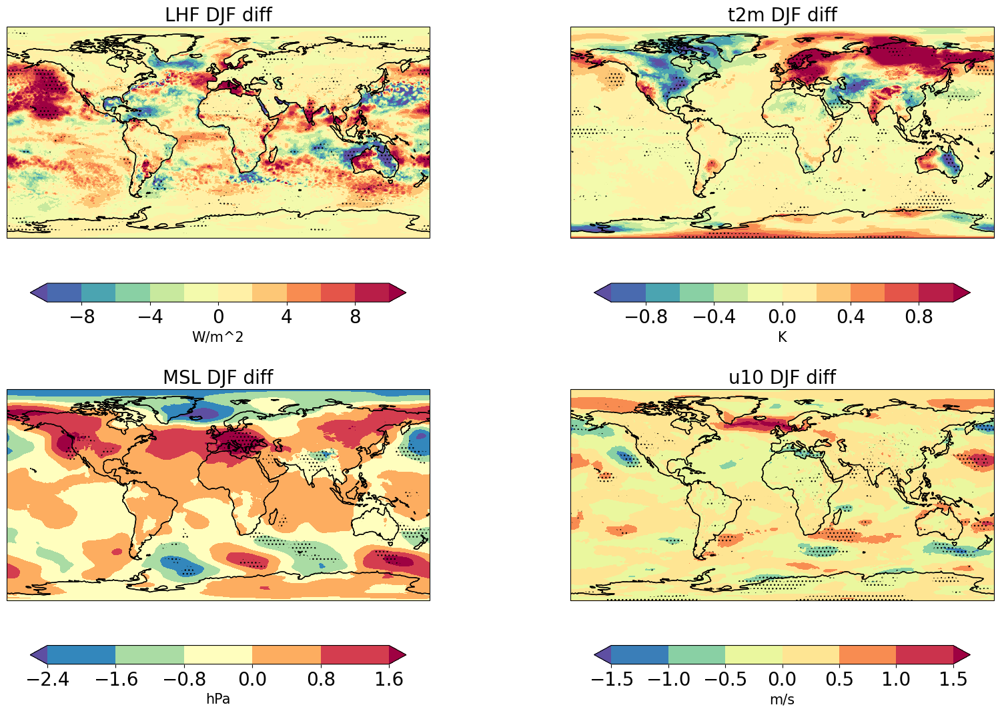

In [20]:
fig=plt.figure(figsize=(20,20))
proj=ccrs.PlateCarree()

lhf_levels = np.linspace(-10, 10, 11)
t2m_levels = np.linspace(-1, 1, 11)

ax1 = plt.subplot(321, projection=proj)
ax1.coastlines(resolution='110m')
p = ax1.contourf(ds.lon, ds.lat, lhf_clm_diff[0],
               #ds.lon.sel(lon=slice(0,60)), ds.lat.sel(lat=slice(40,60)), lhf_clm_diff[0].sel(lat=slice(40,60),lon=slice(0,60)),
               vmin=-10,vmax=10,levels=lhf_levels,
               extend='both',
               cmap = plt.get_cmap('Spectral_r'),
               transform=ccrs.PlateCarree())
pp=ax1.contourf(ds.lon, ds.lat, lhf_clmdiff_mask, colors='none', #alpha=0.5,
               #vmin=-1,vmax=1,levels=levels,
               hatches=['...','...'],linewidth=15,
               #transform=ccrs.PlateCarree()
               )
cbar = plt.colorbar(p, orientation='horizontal', shrink=0.8)
cbar.set_label('W/m^2',fontsize=15)
#cbar.set_clim(0,5)
cbar.ax.tick_params(labelsize=20)
ax1.coastlines()
ax1.set_title('LHF DJF diff',fontsize=20)
#ax1.set_global()

ax3 = plt.subplot(323, projection=proj)
ax3.coastlines(resolution='110m')
p = ax3.contourf(ds.lon, ds.lat, msl_clm_diff[0],
                #vmin=-1,vmax=1,levels=levels,
              extend='both',
              cmap = plt.get_cmap('Spectral_r'),
              transform=ccrs.PlateCarree())
pp=ax3.contourf(ds.lon, ds.lat, msl_clmdiff_mask, colors='none',
               #vmin=-1,vmax=1,levels=levels,
               hatches=['...','...'],linewidth=15,
               #transform=ccrs.PlateCarree()
               )
cbar = plt.colorbar(p, orientation='horizontal', shrink=0.8)
cbar.set_label('hPa',fontsize=15)
#cbar.set_clim(0,5)
cbar.ax.tick_params(labelsize=20)
ax3.coastlines()
ax3.set_title('MSL DJF diff',fontsize=20)
#ax1.set_global()

ax4 = plt.subplot(324, projection=proj)
ax4.coastlines(resolution='110m')
p = ax4.contourf(ds.lon, ds.lat, u10_clm_diff[0],
                 #vmin=-1,vmax=1,levels=levels,
               extend='both',
               cmap = plt.get_cmap('Spectral_r'),
               transform=ccrs.PlateCarree())
pp=ax4.contourf(ds.lon, ds.lat, u10_clmdiff_mask, colors='none',
               #vmin=-1,vmax=1,levels=levels,
               hatches=['...','...'],linewidth=15,
               #transform=ccrs.PlateCarree()
               )
cbar = plt.colorbar(p, orientation='horizontal', shrink=0.8)
cbar.set_label('m/s',fontsize=15)
#cbar.set_clim(0,5)
cbar.ax.tick_params(labelsize=20)
ax4.coastlines()
ax4.set_title('u10 DJF diff',fontsize=20)
#ax1.set_global()

ax6 = plt.subplot(322, projection=proj)
ax6.coastlines(resolution='110m')
p = ax6.contourf(ds.lon, ds.lat, t2m_clm_diff[0],
               vmin=-1,vmax=1,levels=t2m_levels,
               extend='both',
               cmap = plt.get_cmap('Spectral_r'),
               transform=ccrs.PlateCarree())
pp=ax6.contourf(ds.lon, ds.lat, t2m_clmdiff_mask, colors='none',
               #vmin=-1,vmax=1,levels=t2m_levels,
               hatches=['...','...'],linewidth=15,
               #transform=ccrs.PlateCarree()
               )
cbar = plt.colorbar(p, orientation='horizontal', shrink=0.8)
cbar.set_label('K',fontsize=15)
#cbar.set_clim(0,5)
cbar.ax.tick_params(labelsize=20)
ax6.coastlines()
ax6.set_title('t2m DJF diff',fontsize=20)
#ax1.set_global()


#ax1.set_global()
#plt.savefig('....png', bbox_inches='tight', dpi=300)

### Effect of prescribed eddy-rich SST-forcing on the winter mean state in the North Atlantic
#### Mean latent heat flux 
#### Presence of meso-scale SST anomalies along the GS enhances latent heat flux into the atmosphere

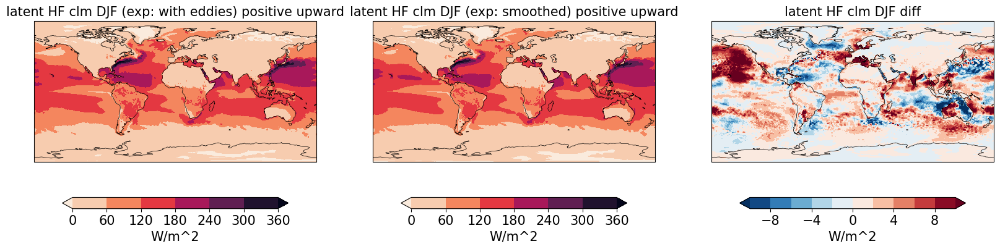

In [21]:
f=plt.figure(figsize=(20,5))

proj=ccrs.PlateCarree()
levels = np.linspace(-10, 10, 11)
#levels_contour = np.linspace(-20, 20, 6)

ax1 = plt.subplot(131,projection=proj)
ax1.coastlines(resolution='110m', linewidth=0.5)
p = ax1.contourf(ds.lon,ds.lat,lhf_clm[0]*(-1),
                   #vmin=-20,vmax=20,levels=levels,
                   extend='both',
                   cmap = plt.get_cmap('rocket_r'))
cbar = plt.colorbar(p, orientation='horizontal', shrink=0.8)
cbar.set_label('W/m^2',fontsize=15)
ax1.set_title('latent HF clm DJF (exp: with eddies) positive upward',fontsize=15)
ax1.set_xlabel('lon',fontsize=15)
ax1.set_ylabel('lat',fontsize=15)
#ax1.set_ylim(ax1.get_ylim()[::-1])
ax1.xaxis.set_tick_params(labelsize=15)
ax1.yaxis.set_tick_params(labelsize=15)
cbar.ax.tick_params(labelsize=15)

ax2 = plt.subplot(132,projection=proj)
ax2.coastlines(resolution='110m', linewidth=0.5)
p = ax2.contourf(ds.lon,ds.lat,lhf_smooth_clm[0]*(-1),
                   #vmin=-20,vmax=20,levels=levels,
                   extend='both',
                   cmap = plt.get_cmap('rocket_r'))
cbar = plt.colorbar(p, orientation='horizontal', shrink=0.8)
cbar.set_label('W/m^2',fontsize=15)
ax2.set_title('latent HF clm DJF (exp: smoothed) positive upward',fontsize=15)
ax2.set_xlabel('lon',fontsize=15)
ax2.set_ylabel('lat',fontsize=15)
#ax2.set_ylim(ax2.get_ylim()[::-1])
ax2.xaxis.set_tick_params(labelsize=15)
ax2.yaxis.set_tick_params(labelsize=15)
cbar.ax.tick_params(labelsize=15)

ax3 = plt.subplot(133,projection=proj)
ax3.coastlines(resolution='110m', linewidth=0.5)
p = ax3.contourf(ds.lon,ds.lat,lhf_clm_diff[0],
                   vmin=-10,vmax=10,levels=levels,
                   extend='both',
                   cmap = plt.get_cmap('RdBu_r'))
cbar = plt.colorbar(p, orientation='horizontal', shrink=0.8)
cbar.set_label('W/m^2',fontsize=15)
ax3.set_title('latent HF clm DJF diff',fontsize=15)
ax3.set_xlabel('lon',fontsize=15)
ax3.set_ylabel('lat',fontsize=15)
#ax2.set_ylim(ax2.get_ylim()[::-1])
ax3.xaxis.set_tick_params(labelsize=15)
ax3.yaxis.set_tick_params(labelsize=15)
cbar.ax.tick_params(labelsize=15)

### Effect of prescribed eddy-rich SST-forcing on the winter mean state in the North Atlantic
#### 10-m zonal wind
#### meso-scale SST forcing might affect the position of the mean wind. Plotting u300 is suggested.  

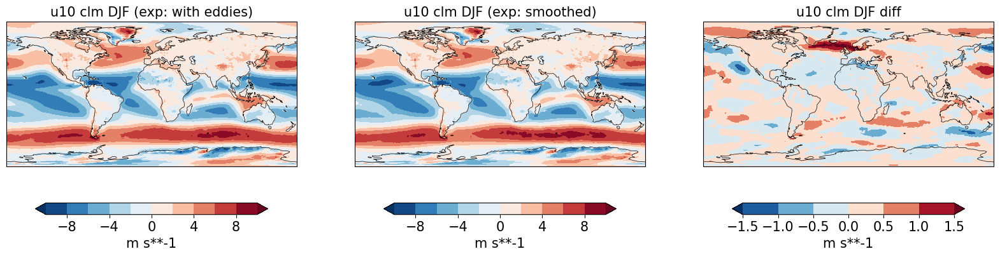

In [22]:
f=plt.figure(figsize=(20,5))

proj=ccrs.PlateCarree()
levels = np.linspace(-10, 10, 11)
#levels_contour = np.linspace(-20, 20, 6)

ax1 = plt.subplot(131,projection=proj)
ax1.coastlines(resolution='110m', linewidth=0.5)
p = ax1.contourf(ds.lon,ds.lat,u10_clm[0],
                   vmin=-10,vmax=10,levels=levels,
                   extend='both',
                   cmap = plt.get_cmap('RdBu_r'))
cbar = plt.colorbar(p, orientation='horizontal', shrink=0.8)
cbar.set_label('m s**-1',fontsize=15)
ax1.set_title('u10 clm DJF (exp: with eddies)',fontsize=15)
ax1.set_xlabel('lon',fontsize=15)
ax1.set_ylabel('lat',fontsize=15)
#ax1.set_ylim(ax1.get_ylim()[::-1])
ax1.xaxis.set_tick_params(labelsize=15)
ax1.yaxis.set_tick_params(labelsize=15)
cbar.ax.tick_params(labelsize=15)

ax2 = plt.subplot(132, projection=proj)
ax2.coastlines(resolution='110m', linewidth=0.5)
p = ax2.contourf(ds.lon,ds.lat,u10_smooth_clm[0],
                   vmin=-10,vmax=10,levels=levels,
                   extend='both',
                   cmap = plt.get_cmap('RdBu_r'))
cbar = plt.colorbar(p, orientation='horizontal', shrink=0.8)
cbar.set_label('m s**-1',fontsize=15)
ax2.set_title('u10 clm DJF (exp: smoothed)',fontsize=15)
ax2.set_xlabel('lon',fontsize=15)
ax2.set_ylabel('lat',fontsize=15)
#ax2.set_ylim(ax2.get_ylim()[::-1])
ax2.xaxis.set_tick_params(labelsize=15)
ax2.yaxis.set_tick_params(labelsize=15)
cbar.ax.tick_params(labelsize=15)

ax3 = plt.subplot(133, projection=proj)
ax3.coastlines(resolution='110m', linewidth=0.5)
p = ax3.contourf(ds.lon,ds.lat,u10_clm_diff[0],
                   #vmin=-100,vmax=100,levels=levels,
                   extend='both',
                   cmap = plt.get_cmap('RdBu_r'),
                transform=ccrs.PlateCarree())
cbar = plt.colorbar(p, orientation='horizontal', shrink=0.8)
cbar.set_label('m s**-1',fontsize=15)
ax3.set_title('u10 clm DJF diff',fontsize=15)
ax3.set_xlabel('lon',fontsize=15)
ax3.set_ylabel('lat',fontsize=15)
#ax2.set_ylim(ax2.get_ylim()[::-1])
ax3.xaxis.set_tick_params(labelsize=15)
ax3.yaxis.set_tick_params(labelsize=15)
cbar.ax.tick_params(labelsize=15)

### Effect of prescribed eddy-rich SST-forcing on the winter mean state in the North Atlantic
#### 2-m temperature

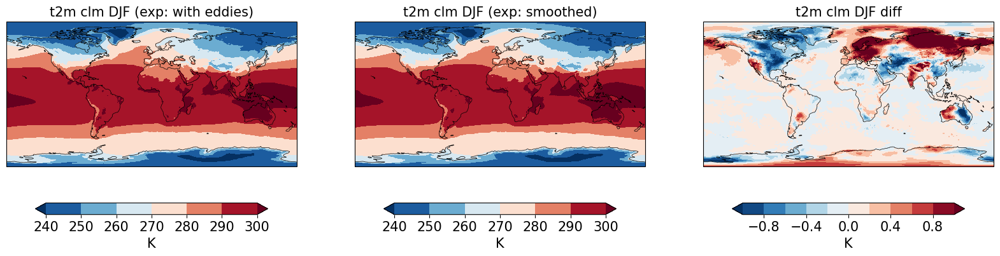

In [23]:
f=plt.figure(figsize=(20,5))

proj=ccrs.PlateCarree()
levels = np.linspace(-1, 1, 11)
#levels_contour = np.linspace(-20, 20, 6)

ax1 = plt.subplot(131,projection=proj)
ax1.coastlines(resolution='110m', linewidth=0.5)
p = ax1.contourf(ds.lon,ds.lat,t2m_clm[0],
                   #vmin=-20,vmax=20,levels=levels,
                   extend='both',
                   cmap = plt.get_cmap('RdBu_r'))
cbar = plt.colorbar(p, orientation='horizontal', shrink=0.8)
cbar.set_label('K',fontsize=15)
ax1.set_title('t2m clm DJF (exp: with eddies)',fontsize=15)
ax1.set_xlabel('lon',fontsize=15)
ax1.set_ylabel('lat',fontsize=15)
#ax1.set_ylim(ax1.get_ylim()[::-1])
ax1.xaxis.set_tick_params(labelsize=15)
ax1.yaxis.set_tick_params(labelsize=15)
cbar.ax.tick_params(labelsize=15)

ax2 = plt.subplot(132,projection=proj)
ax2.coastlines(resolution='110m', linewidth=0.5)
p = ax2.contourf(ds.lon,ds.lat,t2m_smooth_clm[0],
                   #vmin=-20,vmax=20,levels=levels,
                   extend='both',
                   cmap = plt.get_cmap('RdBu_r'))
cbar = plt.colorbar(p, orientation='horizontal', shrink=0.8)
cbar.set_label('K',fontsize=15)
ax2.set_title('t2m clm DJF (exp: smoothed)',fontsize=15)
ax2.set_xlabel('lon',fontsize=15)
ax2.set_ylabel('lat',fontsize=15)
#ax2.set_ylim(ax2.get_ylim()[::-1])
ax2.xaxis.set_tick_params(labelsize=15)
ax2.yaxis.set_tick_params(labelsize=15)
cbar.ax.tick_params(labelsize=15)

ax3 = plt.subplot(133,projection=proj)
ax3.coastlines(resolution='110m', linewidth=0.5)
p = ax3.contourf(ds.lon,ds.lat,t2m_clm_diff[0],
                   vmin=-1,vmax=1,levels=levels,
                   extend='both',
                   cmap = plt.get_cmap('RdBu_r'))
cbar = plt.colorbar(p, orientation='horizontal', shrink=0.8)
cbar.set_label('K',fontsize=15)
ax3.set_title('t2m clm DJF diff',fontsize=15)
ax3.set_xlabel('lon',fontsize=15)
ax3.set_ylabel('lat',fontsize=15)
#ax2.set_ylim(ax2.get_ylim()[::-1])
ax3.xaxis.set_tick_params(labelsize=15)
ax3.yaxis.set_tick_params(labelsize=15)
cbar.ax.tick_params(labelsize=15)

### Effect of prescribed eddy-rich SST-forcing on the winter mean state in the North Atlantic
#### sea level pressure

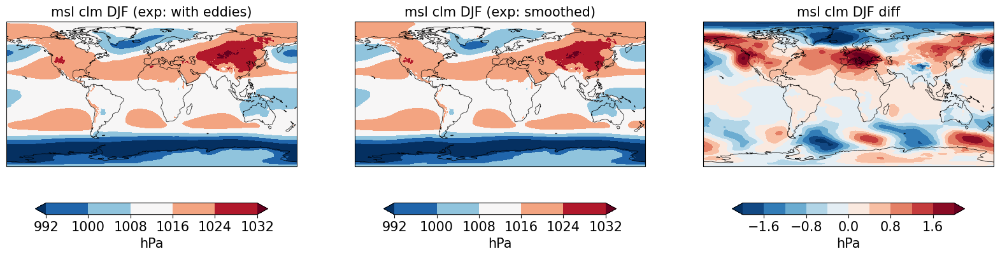

In [24]:
f=plt.figure(figsize=(20,5))

proj=ccrs.PlateCarree()
levels = np.linspace(-2, 2, 11)
#levels_contour = np.linspace(-20, 20, 6)

ax1 = plt.subplot(131,projection=proj)
ax1.coastlines(resolution='110m', linewidth=0.5)
p = ax1.contourf(ds.lon,ds.lat,msl_clm[0],
                   #vmin=-20,vmax=20,levels=levels,
                   extend='both',
                   cmap = plt.get_cmap('RdBu_r'))
cbar = plt.colorbar(p, orientation='horizontal', shrink=0.8)
cbar.set_label('hPa',fontsize=15)
ax1.set_title('msl clm DJF (exp: with eddies)',fontsize=15)
ax1.set_xlabel('lon',fontsize=15)
ax1.set_ylabel('lat',fontsize=15)
#ax1.set_ylim(ax1.get_ylim()[::-1])
ax1.xaxis.set_tick_params(labelsize=15)
ax1.yaxis.set_tick_params(labelsize=15)
cbar.ax.tick_params(labelsize=15)

ax2 = plt.subplot(132, projection=proj)
ax2.coastlines(resolution='110m', linewidth=0.5)
p = ax2.contourf(ds.lon,ds.lat,msl_smooth_clm[0],
                   #vmin=-20,vmax=20,levels=levels,
                   extend='both',
                   cmap = plt.get_cmap('RdBu_r'))
cbar = plt.colorbar(p, orientation='horizontal', shrink=0.8)
cbar.set_label('hPa',fontsize=15)
ax2.set_title('msl clm DJF (exp: smoothed)',fontsize=15)
ax2.set_xlabel('lon',fontsize=15)
ax2.set_ylabel('lat',fontsize=15)
#ax2.set_ylim(ax2.get_ylim()[::-1])
ax2.xaxis.set_tick_params(labelsize=15)
ax2.yaxis.set_tick_params(labelsize=15)
cbar.ax.tick_params(labelsize=15)

ax3 = plt.subplot(133, projection=proj)
ax3.coastlines(resolution='110m', linewidth=0.5)
p = ax3.contourf(ds.lon,ds.lat,msl_clm_diff[0],
                   vmin=-2,vmax=2,levels=levels,
                   extend='both',
                   cmap = plt.get_cmap('RdBu_r'),
                transform=ccrs.PlateCarree())
cbar = plt.colorbar(p, orientation='horizontal', shrink=0.8)
cbar.set_label('hPa',fontsize=15)
ax3.set_title('msl clm DJF diff',fontsize=15)
ax3.set_xlabel('lon',fontsize=15)
ax3.set_ylabel('lat',fontsize=15)
#ax2.set_ylim(ax2.get_ylim()[::-1])
ax3.xaxis.set_tick_params(labelsize=15)
ax3.yaxis.set_tick_params(labelsize=15)
cbar.ax.tick_params(labelsize=15)